In [1]:
# IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES,
# THEN FEEL FREE TO DELETE THIS CELL.
# NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
# ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
# NOTEBOOK./root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1
# /content/labels_with_dont_care
import kagglehub
klemenko_kitti_dataset_path = kagglehub.dataset_download('klemenko/kitti-dataset')

print('Data source import complete.')


Data source import complete.


In [2]:
!pip install ultralytics

In [3]:
print(klemenko_kitti_dataset_path)




/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1


In [4]:
# YOLOv8 Object Detection Training Script for KITTI Dataset
import os
import shutil
import yaml
import random
import torch
import numpy as np
from pathlib import Path
from PIL import Image
from sklearn.model_selection import train_test_split
from ultralytics import YOLO

# 1. Setup and Configuration

In [5]:
import torch
from pathlib import Path

KITTI_BASE_DIR = '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1'
"""str: The base directory where the KITTI dataset is located."""

IMAGE_DIR = Path(KITTI_BASE_DIR) / 'data_object_image_2' / 'training' / 'image_2'
"""Path: Directory containing KITTI training images."""

LABEL_DIR = Path(KITTI_BASE_DIR) / 'data_object_label_2' / 'training' / 'label_2'
"""Path: Directory containing KITTI training labels."""

TRAIN_DIR = Path(KITTI_BASE_DIR)/'train'
"""Path: Directory where training images and labels will be stored in YOLOv5 format."""

VALID_DIR = Path(KITTI_BASE_DIR)/'valid'
"""Path: Directory where validation images and labels will be stored in YOLOv5 format."""

LABELS_DIR = Path(KITTI_BASE_DIR)/'labels_with_dont_care'
"""Path: Directory where YOLOv5-formatted labels will be stored."""

CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
list of str: List of class names included in the KITTI dataset.
'CLASSES' should reflect all possible object categories for detection.
"""

# YOLOv5 model configuration (YOLOv5 uses .yaml files for model config)
MODEL_ARCH = 'yolov5s.yaml'  # Example, adjust according to your variant
"""str: The YOLOv5 model configuration file to use."""

EPOCHS = 50
"""int: Number of epochs for training. Adjust this value based on dataset size and desired training time."""

BATCH_SIZE = 16
"""int: Batch size used during training. Adjust based on GPU memory constraints."""

IMG_SIZE = 640
"""int: The size (height and width) of the input images for the model."""

CONFIDENCE_THRESHOLD = 0.25
"""float: The confidence threshold for predictions during validation and testing."""

PROJECT_NAME = 'YOLOv5-KITTI'
"""str: The name of the project folder where YOLOv5 results will be saved."""

EXPERIMENT_NAME = 'exp1'
"""str: The name of the experiment folder within the project directory to store this run's results."""

device = 'cuda' if torch.cuda.is_available() else 'cpu'
"""str: The device to use for training and inference, defaults to GPU if available."""

print(f"Using device: {device}")



Using device: cuda


# 2. Data Preparation Functions

In [6]:
from PIL import Image
from pathlib import Path

CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]
"""
List of class names included in the KITTI dataset.
'CLASSES' should reflect all possible object categories for detection.
"""

CLAZZ_NUMBERS = {name: idx for idx, name in enumerate(CLASSES)}
"""
dict: A mapping from class names to numeric labels.
The numeric labels are used by YOLO for class indices.
"""

def convert_bbox_to_yolo(bbox, size):
    """
    Convert KITTI bounding box coordinates to YOLO format.

    Args:
        bbox (tuple of float): Bounding box coordinates in the format (left, right, top, bottom).
        size (tuple of int): Image size as (width, height).

    Returns:
        tuple of float: YOLO-formatted bounding box as (x_center, y_center, width, height) normalized by image size.
    """
    dw = 1.0 / size[0]
    dh = 1.0 / size[1]
    x_center = (bbox[0] + bbox[1]) / 2.0
    y_center = (bbox[2] + bbox[3]) / 2.0
    width = bbox[1] - bbox[0]
    height = bbox[3] - bbox[2]
    x_center *= dw
    width *= dw
    y_center *= dh
    height *= dh
    return x_center, y_center, width, height

def parse_kitti_label_file(lbl_path, img_path):
    """
    Parse a KITTI label file and convert the bounding boxes to YOLOv5 format.

    Args:
        lbl_path (Path): Path to the KITTI label file (in KITTI text format).
        img_path (Path): Path to the corresponding image file.

    Returns:
        list of tuple: A list of YOLOv5-formatted bounding boxes. Each element is
        (class_idx, x_center, y_center, width, height).
    """
    with open(lbl_path, 'r', encoding='utf-8') as file:
        lines = file.read().strip().split('\n')

    yolo_labels = []
    if not img_path.exists():
        # If the image doesn't exist, skip processing labels
        return yolo_labels

    img_size = Image.open(img_path).size  # (width, height)

    for line in lines:
        parts = line.split()
        clazz = parts[0]
        if clazz not in CLAZZ_NUMBERS:
            # Skip classes not in our mapping
            continue

        # KITTI format:
        # type, truncated, occluded, alpha, bbox_left, bbox_top, bbox_right, bbox_bottom, ...
        # Indices:  0    ,    1     ,   2     ,   3  ,    4     ,    5    ,     6     ,      7    ...
        # Example: Car 0.00 0 1.57 148.00 174.00 350.00 325.00 ...
        # The bounding box coordinates: left = parts[4], top = parts[5], right = parts[6], bottom = parts[7]
        bbox_left = float(parts[4])
        bbox_top = float(parts[5])
        bbox_right = float(parts[6])
        bbox_bottom = float(parts[7])
        bbox = (bbox_left, bbox_right, bbox_top, bbox_bottom)

        # Convert bounding box to YOLO format (normalized)
        x_center, y_center, width, height = convert_bbox_to_yolo(bbox, img_size)
        clazz_number = CLAZZ_NUMBERS[clazz]

        # YOLO format: class x_center y_center width height
        yolo_labels.append((clazz_number, x_center, y_center, width, height))

    return yolo_labels



# 3. Generate YOLO labels

In [7]:
if not LABELS_DIR.exists():
    LABELS_DIR.mkdir()

image_paths = sorted(list(IMAGE_DIR.glob('*.png')))
label_paths = sorted(list(LABEL_DIR.glob('*.txt')))

for img_path in image_paths:
    lbl_path = LABEL_DIR / f"{img_path.stem}.txt"
    if lbl_path.exists():
        yolo_labels = parse_kitti_label_file(lbl_path, img_path)
        yolo_label_path = LABELS_DIR / f"{img_path.stem}.txt"
        with open(yolo_label_path, 'w', encoding='utf-8') as lf:
            for lbl in yolo_labels:
                lf.write(" ".join(f"{val:.6f}" for val in lbl) + "\n")

print("YOLO format labels have been generated in:", LABELS_DIR.resolve())

YOLO format labels have been generated in: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/labels_with_dont_care


# 4. Split Dataset into Train and Validation Sets

In [8]:
labels_for_images = [(img_path, LABELS_DIR / f"{img_path.stem}.txt")
                     for img_path in image_paths
                     if (LABELS_DIR / f"{img_path.stem}.txt").exists()]

train_pairs, valid_pairs = train_test_split(
    labels_for_images,
    test_size=0.1,
    random_state=42,
    shuffle=True
)
print(f"Training samples: {len(train_pairs)}, Validation samples: {len(valid_pairs)}")

# Create directories for YOLO data structure:
for folder in [TRAIN_DIR, VALID_DIR]:
    if folder.exists():
        shutil.rmtree(folder)
    folder.mkdir()
    (folder / 'images').mkdir()
    (folder / 'labels').mkdir()

for img_path, lbl_path in train_pairs:
    shutil.copy(img_path, TRAIN_DIR / 'images' / img_path.name)
    shutil.copy(lbl_path, TRAIN_DIR / 'labels' / lbl_path.name)

for img_path, lbl_path in valid_pairs:
    shutil.copy(img_path, VALID_DIR / 'images' / img_path.name)
    shutil.copy(lbl_path, VALID_DIR / 'labels' / lbl_path.name)

print(f"Training data copied to {TRAIN_DIR / 'images'} and {TRAIN_DIR / 'labels'}")
print(f"Validation data copied to {VALID_DIR / 'images'} and {VALID_DIR / 'labels'}")

Training samples: 6732, Validation samples: 749
Training data copied to /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/images and /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels
Validation data copied to /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images and /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels


# 5. Create data.yaml File for YOLO

In [9]:
import yaml
from pathlib import Path

# Define your class names
CLASSES = [
    'Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting',
    'Cyclist', 'Tram', 'Misc', 'DontCare'
]  # Replace with your actual class names

# Update with the actual paths where you moved your dataset
# These should match the paths in cell 52
TRAIN_DIR = Path(KITTI_BASE_DIR) / 'train' / 'images'
VALID_DIR = Path(KITTI_BASE_DIR) / 'valid' / 'images'

# Define the path for the data.yaml file
DATA_CONFIG = '/content/data.yaml'

# Prepare the data configuration dictionary
data_config = {
    'train': str(TRAIN_DIR.resolve()),  # Absolute path to train images
    'val': str(VALID_DIR.resolve()),    # Absolute path to validation images
    'nc': len(CLASSES),                 # Number of classes
    'names': CLASSES                    # List of class names
}

# Write the data configuration to the data.yaml file
with open(DATA_CONFIG, 'w', encoding='utf-8') as f:
    yaml.dump(data_config, f, default_flow_style=False)

# Output the content of the generated data.yaml file
print("data.yaml file created with content:")
print(data_config)

data.yaml file created with content:
{'train': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/images', 'val': '/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images', 'nc': 9, 'names': ['Car', 'Van', 'Truck', 'Pedestrian', 'Person_sitting', 'Cyclist', 'Tram', 'Misc', 'DontCare']}


In [10]:

!pip install yolov5

# 6. Train the YOLO11 Model

In [11]:
# Clone the YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5.git

# Install dependencies
!pip install -r yolov5/requirements.txt

# Navigate to the repository
%cd yolov5


Cloning into 'yolov5'...
remote: Enumerating objects: 17265, done.
remote: Counting objects: 100% (92/92), done.
remote: Compressing objects: 100% (82/82), done.
remote: Total 17265 (delta 46), reused 10 (delta 10), pack-reused 17173 (from 5)
Receiving objects: 100% (17265/17265), 16.00 MiB | 12.77 MiB/s, done.
Resolving deltas: 100% (11791/11791), done.
/content/yolov5


MODEL ARCHITECTURE


In [13]:
from ultralytics import YOLO
import torch

# Define configuration
MODEL_ARCH = 'yolov5m'  # Changed to 'yolov5m' for the YOLOv5 medium model
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the training parameters
DATA_CONFIG = '/content/data.yaml'  # Path to the generated data.yaml
EPOCHS = 50  # Adjusted to 50 as per the original input
BATCH_SIZE = 16  # Same as before
IMG_SIZE = 640  # Image size remains 640
CONFIDENCE_THRESHOLD = 0.25  # Confidence threshold for validation

PROJECT_NAME = 'YOLOv5-KITTI'  # Project folder name
EXPERIMENT_NAME = 'exp1'  # Experiment name

# Initialize the model with the medium-sized YOLOv5 architecture
model = YOLO('yolov5m.pt').to(device)  # Use yolov5m.pt for medium model weights

# Train the model
train_results = model.train(
    data=DATA_CONFIG,
    epochs=EPOCHS,
    batch=BATCH_SIZE,
    imgsz=IMG_SIZE,
    project=PROJECT_NAME,
    name=EXPERIMENT_NAME,
    device=device,
    exist_ok=True
)

print("\nTraining completed!\n")


PRO TIP 💡 Replace 'model=yolov5m.pt' with new 'model=yolov5mu.pt'.
YOLOv5 'u' models are trained with https://github.com/ultralytics/ultralytics and feature improved performance vs standard YOLOv5 models trained with https://github.com/ultralytics/yolov5.



100%|██████████| 48.2M/48.2M [00:00<00:00, 350MB/s]


Ultralytics 8.3.63 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov5m.pt, data=/content/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=cuda, workers=8, project=YOLOv5-KITTI, name=exp1, exist_ok=True, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=T

100%|██████████| 5.35M/5.35M [00:00<00:00, 106MB/s]


AMP: checks passed ✅


train: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels... 6732 images, 0 backgrounds, 0 corrupt: 100%|██████████| 6732/6732 [00:40<00:00, 168.09it/s]


train: New cache created: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/train/labels.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.0 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:04<00:00, 158.23it/s]

val: New cache created: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels.cache


Plotting labels to YOLOv5-KITTI/exp1/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000769, momentum=0.9) with parameter groups 91 weight(decay=0.0), 98 weight(decay=0.0005), 97 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to YOLOv5-KITTI/exp1
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      6.85G      1.251      1.104      1.065        246        640: 100%|██████████| 421/421 [04:06<00:00,  1.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.86it/s]

                   all        749       5425       0.53      0.408      0.472      0.279



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      6.86G       1.22      0.925      1.061        162        640: 100%|██████████| 421/421 [03:57<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.87it/s]


                   all        749       5425      0.544      0.517      0.542      0.334

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      6.95G      1.198     0.8938      1.056        125        640: 100%|██████████| 421/421 [03:59<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.84it/s]


                   all        749       5425      0.565      0.495      0.536      0.324

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      6.88G      1.178     0.8596      1.044        174        640: 100%|██████████| 421/421 [03:57<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.81it/s]


                   all        749       5425      0.652      0.513      0.578      0.346

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      6.96G      1.145     0.8179       1.03        158        640: 100%|██████████| 421/421 [03:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.88it/s]


                   all        749       5425      0.625      0.584      0.633      0.396

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      6.96G      1.121     0.7823      1.018        195        640: 100%|██████████| 421/421 [03:53<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.88it/s]


                   all        749       5425      0.672      0.626      0.666       0.42

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      6.95G      1.099     0.7568      1.011        197        640: 100%|██████████| 421/421 [03:56<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.82it/s]


                   all        749       5425       0.66      0.605       0.65      0.416

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      6.89G      1.078     0.7373      1.001        160        640: 100%|██████████| 421/421 [03:54<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.87it/s]


                   all        749       5425      0.695       0.58      0.673      0.433

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      6.93G      1.064     0.7188     0.9948        180        640: 100%|██████████| 421/421 [03:54<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.90it/s]


                   all        749       5425      0.782      0.633      0.711      0.463

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      6.83G      1.041     0.6959     0.9852        201        640: 100%|██████████| 421/421 [03:57<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.90it/s]


                   all        749       5425      0.674      0.675      0.718       0.46

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      7.12G       1.03     0.6844     0.9784        195        640: 100%|██████████| 421/421 [03:57<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.03it/s]


                   all        749       5425      0.741      0.651      0.737       0.48

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      6.85G      1.017     0.6728     0.9777        139        640: 100%|██████████| 421/421 [03:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.86it/s]


                   all        749       5425      0.734      0.724      0.765      0.502

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      6.98G      1.003     0.6565     0.9699        183        640: 100%|██████████| 421/421 [03:56<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.96it/s]


                   all        749       5425      0.781      0.707      0.764      0.509

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      6.95G     0.9881     0.6451      0.966        157        640: 100%|██████████| 421/421 [03:56<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.94it/s]

                   all        749       5425      0.765      0.689      0.763      0.498



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      6.94G     0.9828     0.6365     0.9639        107        640: 100%|██████████| 421/421 [03:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.94it/s]


                   all        749       5425       0.76      0.701      0.772      0.505

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      6.87G     0.9613     0.6191      0.955        154        640: 100%|██████████| 421/421 [03:57<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.77it/s]


                   all        749       5425      0.777      0.728      0.778      0.522

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      6.97G     0.9565      0.615     0.9555        176        640: 100%|██████████| 421/421 [03:57<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.92it/s]

                   all        749       5425      0.798      0.734      0.788      0.537



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50       6.9G     0.9489     0.6038     0.9529        164        640: 100%|██████████| 421/421 [03:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.05it/s]


                   all        749       5425      0.828      0.707      0.788      0.539

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      7.11G     0.9386     0.5984     0.9474        199        640: 100%|██████████| 421/421 [03:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.10it/s]

                   all        749       5425      0.823      0.739      0.804      0.548



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      6.88G     0.9251     0.5877     0.9438        256        640: 100%|██████████| 421/421 [03:56<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.92it/s]


                   all        749       5425      0.827      0.768      0.817      0.567

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      6.94G     0.9139     0.5761     0.9398        167        640: 100%|██████████| 421/421 [03:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.91it/s]

                   all        749       5425      0.807      0.746      0.806      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      7.09G     0.9046     0.5724     0.9366        113        640: 100%|██████████| 421/421 [03:51<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.96it/s]

                   all        749       5425       0.81      0.772      0.822      0.573



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      7.13G     0.8976     0.5631     0.9331        168        640: 100%|██████████| 421/421 [03:53<00:00,  1.80it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.97it/s]

                   all        749       5425      0.799      0.771      0.825      0.575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      6.87G     0.8944     0.5582     0.9335        117        640: 100%|██████████| 421/421 [03:51<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.96it/s]


                   all        749       5425      0.839      0.743      0.817       0.57

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      6.96G      0.883      0.551     0.9291        196        640: 100%|██████████| 421/421 [03:50<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.95it/s]


                   all        749       5425      0.855      0.752      0.828      0.583

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      7.12G       0.88     0.5483     0.9275        190        640: 100%|██████████| 421/421 [03:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  2.00it/s]


                   all        749       5425      0.826      0.777       0.83      0.593

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      7.05G     0.8636     0.5353     0.9222        179        640: 100%|██████████| 421/421 [03:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.87it/s]


                   all        749       5425      0.838      0.788      0.834       0.59

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      7.04G     0.8598     0.5322     0.9199        212        640: 100%|██████████| 421/421 [03:52<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.94it/s]


                   all        749       5425      0.855      0.772      0.831      0.595

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      6.93G     0.8547     0.5297     0.9185        182        640: 100%|██████████| 421/421 [03:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.23it/s]

                   all        749       5425      0.845      0.784      0.842      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      7.11G      0.845     0.5199     0.9162        198        640: 100%|██████████| 421/421 [03:56<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:13<00:00,  1.84it/s]


                   all        749       5425      0.855      0.799      0.846      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      6.95G     0.8354     0.5151     0.9157        181        640: 100%|██████████| 421/421 [03:57<00:00,  1.77it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.29it/s]


                   all        749       5425      0.833      0.811      0.849      0.621

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50       6.9G     0.8275     0.5069      0.909        171        640: 100%|██████████| 421/421 [03:56<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.94it/s]

                   all        749       5425       0.86      0.784      0.849       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      6.93G     0.8207     0.5023     0.9072        148        640: 100%|██████████| 421/421 [03:59<00:00,  1.76it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.94it/s]


                   all        749       5425      0.846      0.805      0.852      0.621

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      6.95G     0.8128     0.4944     0.9029        174        640: 100%|██████████| 421/421 [03:55<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.02it/s]

                   all        749       5425      0.828      0.811      0.849      0.619



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      7.09G     0.8011     0.4905     0.9025        187        640: 100%|██████████| 421/421 [03:56<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.88it/s]


                   all        749       5425      0.856       0.81      0.854      0.623

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      6.81G      0.797     0.4833     0.9018        195        640: 100%|██████████| 421/421 [03:55<00:00,  1.79it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.98it/s]

                   all        749       5425      0.859      0.811      0.852      0.629



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      7.11G     0.7839     0.4789     0.8965        141        640: 100%|██████████| 421/421 [03:55<00:00,  1.78it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.62it/s]


                   all        749       5425      0.841      0.802      0.858      0.629

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      7.11G     0.7782     0.4712     0.8938        207        640: 100%|██████████| 421/421 [03:52<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.91it/s]

                   all        749       5425      0.856       0.82       0.86      0.635



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      7.07G     0.7724     0.4702     0.8929        133        640: 100%|██████████| 421/421 [03:52<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.08it/s]


                   all        749       5425      0.844      0.825      0.858      0.638

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50       6.9G     0.7624     0.4622     0.8882        129        640: 100%|██████████| 421/421 [03:51<00:00,  1.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.96it/s]


                   all        749       5425      0.848      0.812      0.859      0.636
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      6.85G     0.7633     0.4491     0.8847        101        640: 100%|██████████| 421/421 [03:53<00:00,  1.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.10it/s]

                   all        749       5425      0.857      0.819      0.863      0.639



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      6.86G     0.7485     0.4419     0.8801         75        640: 100%|██████████| 421/421 [03:50<00:00,  1.83it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.44it/s]


                   all        749       5425      0.874       0.82      0.864      0.647

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      7.02G     0.7378     0.4353     0.8765         73        640: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.15it/s]

                   all        749       5425      0.871      0.822      0.868      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      6.74G     0.7284     0.4303     0.8731         97        640: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.22it/s]

                   all        749       5425      0.862      0.836      0.871      0.654



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      6.82G     0.7161     0.4234     0.8685        104        640: 100%|██████████| 421/421 [03:47<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.32it/s]

                   all        749       5425      0.864      0.829      0.871      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      6.88G     0.7122     0.4189     0.8697         74        640: 100%|██████████| 421/421 [03:49<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.33it/s]


                   all        749       5425      0.857       0.83      0.868      0.656

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50         7G     0.7031     0.4126     0.8657         86        640: 100%|██████████| 421/421 [03:47<00:00,  1.85it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.22it/s]


                   all        749       5425      0.874      0.826      0.872      0.661

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      6.78G     0.6942     0.4094      0.864        102        640: 100%|██████████| 421/421 [03:45<00:00,  1.87it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:09<00:00,  2.49it/s]


                   all        749       5425       0.87      0.837      0.873      0.661

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      6.87G     0.6845     0.4023     0.8614         71        640: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:10<00:00,  2.26it/s]

                   all        749       5425      0.857      0.839      0.871      0.662



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      6.87G     0.6803     0.3995     0.8605         60        640: 100%|██████████| 421/421 [03:48<00:00,  1.84it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:11<00:00,  2.05it/s]

                   all        749       5425      0.852      0.843      0.873      0.664



50 epochs completed in 3.522 hours.
Optimizer stripped from YOLOv5-KITTI/exp1/weights/last.pt, 50.5MB
Optimizer stripped from YOLOv5-KITTI/exp1/weights/best.pt, 50.5MB

Validating YOLOv5-KITTI/exp1/weights/best.pt...
Ultralytics 8.3.63 🚀 Python-3.11.11 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv5m summary (fused): 248 layers, 25,050,427 parameters, 0 gradients, 64.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 24/24 [00:12<00:00,  1.85it/s]


                   all        749       5425      0.852      0.842      0.873      0.664
                   Car        678       3040      0.923      0.958       0.98       0.84
                   Van        223        296      0.898      0.956      0.979      0.829
                 Truck        102        104      0.937      0.971      0.976      0.832
            Pedestrian        179        441      0.834      0.785      0.846      0.528
        Person_sitting         12         25      0.797      0.787      0.825      0.582
               Cyclist        124        174      0.925      0.857      0.914      0.659
                  Tram         29         56      0.912      0.927      0.972      0.796
                  Misc         75         91      0.871      0.962      0.961      0.765
              DontCare        567       1198      0.569      0.378      0.403      0.145
Speed: 0.2ms preprocess, 3.0ms inference, 0.0ms loss, 2.3ms postprocess per image
Results saved to YOLOv5-KITT

# 7. Validate the Model

In [14]:
best_weights_path = f'{PROJECT_NAME}/{EXPERIMENT_NAME}/weights/best.pt'
model = YOLO(best_weights_path).to(device)
validation_results = model.val(
    data=DATA_CONFIG,
    split='val',
    conf=CONFIDENCE_THRESHOLD,
    save=False,
    plots=False
)
print("\nValidation completed!\n")

# The result from model.val() is a 'DetMetrics' object that summarizes performance.
# The 'DetMetrics' class holds detection metrics, including mean precision (mp), mean recall (mr),
# mAP (map50, map50-95), and others.
# Let's inspect the attributes of validation_results for these metrics.

print("Validation Results (raw DetMetrics object):")
print(validation_results)

# According to Ultralytics YOLO code, `validation_results` is a `DetMetrics` object that has a 'box' attribute
# which holds metrics. We can inspect `validation_results.box` as it may contain the summary metrics.
print("Attributes of validation_results:")
for attribute in dir(validation_results):
    if not attribute.startswith('_'):
        print(attribute, "=", getattr(validation_results, attribute))

# Access relevant metrics from the DetMetrics object
metrics = validation_results.box  # box is an instance of the Metric class storing results for boxes
print("\nBox Metrics:")
print(metrics)

# The metrics attribute should include values like 'mp' (mean precision), 'mr' (mean recall), etc.
# According to the docs:
# - metrics.ap50: average precision at IoU=0.50
# - metrics.ap: average precision for IoU=0.50:0.95
# - metrics.mp: mean precision
# - metrics.mr: mean recall
# - metrics.map50: mean average precision at IoU=0.50
# - metrics.map: mean average precision at IoU=0.50:0.95

# We will attempt to retrieve these metrics:
precision = getattr(metrics, 'mp', None)
recall = getattr(metrics, 'mr', None)

# Calculate F1 score if precision and recall are available
f1_score = None
if precision is not None and recall is not None and (precision + recall) > 0:
    f1_score = 2 * (precision * recall) / (precision + recall)

# Accuracy is not directly applicable to object detection tasks like YOLO
accuracy = None

# Placeholder for confusion matrix
confusion_matrix = None

# Print metrics in the requested format
print("\nConfusion Matrix:")
if confusion_matrix is not None:
    print(confusion_matrix)
else:
    print("[[ ... ]]")  # Placeholder for an actual confusion matrix if implemented

if accuracy is not None:
    print(f"Accuracy: {accuracy * 100:.2f}%")
else:
    print("Accuracy: Not Applicable for object detection")

if precision is not None:
    print(f"Precision: {precision:.2f}")
else:
    print("Precision: Not Available")

if recall is not None:
    print(f"Recall: {recall:.2f}")
else:
    print("Recall: Not Available")

if f1_score is not None:
    print(f"F1 Score: {f1_score:.2f}")
else:
    print("F1 Score: Not Available")

YOLOv5m summary (fused): 248 layers, 25,050,427 parameters, 0 gradients, 64.0 GFLOPs


val: Scanning /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/labels.cache... 749 images, 0 backgrounds, 0 corrupt: 100%|██████████| 749/749 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:19<00:00,  2.43it/s]


                   all        749       5425      0.842      0.851      0.881      0.701
                   Car        678       3040      0.912      0.962      0.975      0.863
                   Van        223        296       0.89      0.959      0.971      0.849
                 Truck        102        104      0.935      0.971      0.976      0.852
            Pedestrian        179        441      0.802      0.791       0.85      0.576
        Person_sitting         12         25        0.8        0.8      0.858      0.637
               Cyclist        124        174      0.932      0.862      0.923      0.718
                  Tram         29         56      0.912      0.929      0.954      0.819
                  Misc         75         91      0.863      0.967      0.972      0.804
              DontCare        567       1198      0.527      0.417      0.445      0.188
Speed: 0.1ms preprocess, 6.6ms inference, 0.0ms loss, 3.2ms postprocess per image

Validation completed!

Vali

# 8. Predictions on Validation Set (Optional)

In [15]:
val_predictions = model.predict(
    source=str((VALID_DIR).resolve()),
    save=True,
    conf=CONFIDENCE_THRESHOLD
)

if val_predictions:
    predictions_save_dir = val_predictions[0].save_dir
    print(f"\nPredictions saved to '{predictions_save_dir}'.\n")
else:
    print("No predictions were made.")


image 1/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000019.png: 224x640 2 Cars, 1 Van, 1 Truck, 2 DontCares, 64.5ms
image 2/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000031.png: 224x640 5 Cars, 1 Van, 1 Truck, 2 DontCares, 16.3ms
image 3/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000037.png: 224x640 4 Cars, 1 Truck, 16.4ms
image 4/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000041.png: 224x640 1 Car, 2 DontCares, 16.3ms
image 5/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000048.png: 224x640 3 Pedestrians, 1 Cyclist, 2 DontCares, 16.3ms
image 6/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000050.png: 224x640 4 Cars, 1 Van, 16.3ms
image 7/749 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/valid/images/000061.png: 224x640 3 Cars, 2 Vans,

In [16]:
%matplotlib inline

# object detection

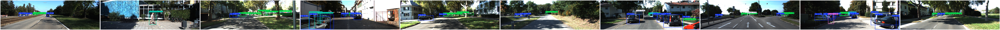

In [17]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

# Define the directory where the predictions are saved
prediction_dir = 'runs/detect/predict'

# List all images in the prediction directory
images = os.listdir(prediction_dir)

# Display up to 10 images with predictions
num_images_to_display = min(10, len(images))  # Ensure we don't exceed the number of available images
fig, axes = plt.subplots(1, num_images_to_display, figsize=(200, 100))  # Create a row of subplots

for i in range(num_images_to_display):
    img_path = os.path.join(prediction_dir, images[i])  # Get image path
    img = mpimg.imread(img_path)  # Load the image
    axes[i].imshow(img)  # Show image on the corresponding subplot
    axes[i].axis('off')  # Disable axis for the subplot

plt.tight_layout()  # Adjust spacing between images
plt.show()



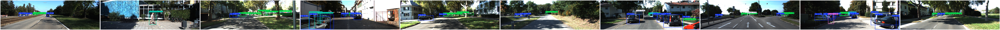

In [18]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import numpy as np
import pandas as pd

# Define the directory where the predictions are saved
prediction_dir = 'runs/detect/predict'

# Define the path to the KITTI labels directory
LABEL_DIR = 'path_to_label_directory'  # Set this to your actual label directory

# List all images in the prediction directory
images = os.listdir(prediction_dir)

# Function to calculate Euclidean distance
def calculate_distance(x, y, z):
    return np.sqrt(x**2 + y**2 + z**2)

# Function to process KITTI labels for object data
def process_kitti_labels(image_name):
    label_file = os.path.join(LABEL_DIR, f'{image_name[:-4]}.txt')  # Assumes .txt labels match image names (without extension)

    # Check if label file exists
    if not os.path.exists(label_file):
        return []

    labels = pd.read_csv(label_file, header=None, delimiter=' ')  # Read label file (space-separated)

    object_data = []
    for index, row in labels.iterrows():
        object_type = row[0]  # Object type (e.g., Car, Pedestrian)
        occluded = int(row[2])  # Occlusion status

        # Only consider fully visible objects
        if occluded == 0:
            location = row[11:14].values  # 3D location (x, y, z)
            distance = calculate_distance(location[0], location[1], location[2])  # Calculate Euclidean distance
            bbox = row[4:8].values  # Bounding box coordinates (left, top, right, bottom)
            object_data.append((object_type, distance, bbox))

    return object_data

# Display up to 10 images with distance predictions
num_images_to_display = min(10, len(images))  # Ensure we don't exceed the number of available images
fig, axes = plt.subplots(1, num_images_to_display, figsize=(200, 100))  # Create a row of subplots

for i in range(num_images_to_display):
    img_path = os.path.join(prediction_dir, images[i])  # Get image path
    img = mpimg.imread(img_path)  # Load the image

    # Process KITTI labels for this specific image
    visible_objects = process_kitti_labels(images[i])  # Get object data for this image

    axes[i].imshow(img)  # Show image on the corresponding subplot

    # Loop through objects and annotate the distance
    for obj in visible_objects:
        object_type, distance, bbox = obj

        # Draw bounding box
        axes[i].add_patch(plt.Rectangle((bbox[0], bbox[1]), bbox[2] - bbox[0], bbox[3] - bbox[1],
                                        linewidth=2, edgecolor='g', facecolor='none'))

        # Annotate the object type and distance
        axes[i].text(bbox[0], bbox[1] - 5, f'{object_type}: {distance:.2f}m', color='red', fontsize=12)

    axes[i].axis('off')  # Disable axis for the subplot

plt.tight_layout()  # Adjust spacing between images
plt.show()


Processing 006079.jpg...
Processing 001406.jpg...
Processing 000544.jpg...
Processing 000401.jpg...
Processing 000997.jpg...
Processing 004112.jpg...
Processing 000031.jpg...
Processing 003977.jpg...
Processing 002812.jpg...
Processing 002676.jpg...
Processing 007293.jpg...
Processing 004030.jpg...
Processing 007115.jpg...
Processing 005189.jpg...
Processing 003751.jpg...
Processing 003078.jpg...
Processing 000079.jpg...
Processing 000251.jpg...
Processing 004411.jpg...
Processing 001893.jpg...
Processing 004834.jpg...
Processing 005711.jpg...
Processing 002986.jpg...
Processing 002337.jpg...
Processing 003316.jpg...
Processing 005265.jpg...
Processing 001215.jpg...
Processing 004267.jpg...
Processing 000491.jpg...
Processing 005283.jpg...
Processing 001176.jpg...
Processing 002107.jpg...
Processing 003459.jpg...
Processing 004629.jpg...
Processing 004264.jpg...
Processing 006147.jpg...
Processing 003480.jpg...
Processing 001002.jpg...
Processing 000381.jpg...
Processing 000157.jpg...


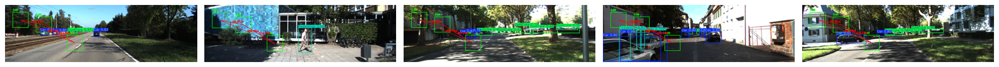

In [19]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path

# Function to compute centroid
def compute_centroid(bbox):
    x1, y1, x2, y2 = bbox
    centroid_x = (x1 + x2) / 2
    centroid_y = (y1 + y2) / 2
    return centroid_x, centroid_y

# Function to compute Euclidean distance
def compute_distance(centroid1, centroid2):
    return np.sqrt((centroid1[0] - centroid2[0]) ** 2 + (centroid1[1] - centroid2[1]) ** 2)

# Function to process a single image and draw distances
def process_image_with_distances(image_path, predictions):
    """
    Args:
        image_path: Path to the image
        predictions: List of bounding boxes and labels
                     Format: [[x1, y1, x2, y2, confidence], ...]
    """
    image = cv2.imread(image_path)

    if image is None:
        print(f"Error: Unable to load image {image_path}")
        return None

    centroids = []

    # Draw bounding boxes and compute centroids
    for pred in predictions:
        x1, y1, x2, y2, confidence = pred
        centroids.append(compute_centroid([x1, y1, x2, y2]))
        label = f"{confidence:.2f}"
        cv2.rectangle(image, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
        cv2.putText(image, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    # Compute distances and draw them
    for i in range(len(centroids)):
        for j in range(i + 1, len(centroids)):
            dist = compute_distance(centroids[i], centroids[j])
            cv2.line(image, (int(centroids[i][0]), int(centroids[i][1])),
                     (int(centroids[j][0]), int(centroids[j][1])), (0, 0, 255), 2)
            mid_x = int((centroids[i][0] + centroids[j][0]) / 2)
            mid_y = int((centroids[i][1] + centroids[j][1]) / 2)
            cv2.putText(image, f"{dist:.2f}px", (mid_x, mid_y), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)

    return cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB for displaying with Matplotlib

# Function to process all images and save distances
def process_all_images(image_dir, output_dir, num_images_to_display=5):
    image_path = Path(image_dir)
    output_path = Path(output_dir)
    output_path.mkdir(parents=True, exist_ok=True)

    image_files = [f for f in image_path.iterdir() if f.suffix in ['.jpg', '.png']]
    num_images_to_display = min(num_images_to_display, len(image_files))

    displayed_images = []

    for img_file in image_files:
        print(f"Processing {img_file.name}...")

        # Mock predictions for testing (Replace with actual extracted data)
        # Format: [[x1, y1, x2, y2, confidence], ...]
        predictions = [
            [50, 50, 150, 150, 0.85],  # Example: bbox and confidence
            [200, 80, 300, 180, 0.90],
            [400, 200, 500, 300, 0.80]
        ]

        processed_image = process_image_with_distances(str(img_file), predictions)

        if processed_image is not None:
            # Save processed image
            output_file = output_path / img_file.name
            plt.imsave(output_file, processed_image)

            # Collect for display if needed
            if len(displayed_images) < num_images_to_display:
                displayed_images.append(processed_image)

    # Display sample images
    fig, axes = plt.subplots(1, num_images_to_display, figsize=(20, 10))
    for i, img in enumerate(displayed_images):
        axes[i].imshow(img)
        axes[i].axis('off')
    plt.tight_layout()
    plt.show()

# Main function
if __name__ == "__main__":
    image_dir = 'runs/detect/predict'  # Directory with images
    output_dir = 'runs/detect/predict_with_distances'  # Directory to save processed images
    process_all_images(image_dir, output_dir, num_images_to_display=5)
